#Verify Hardware

In [1]:
!/usr/local/cuda/bin/nvcc --version
!nvidia-smi

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Wed_Jul_22_19:09:09_PDT_2020
Cuda compilation tools, release 11.0, V11.0.221
Build cuda_11.0_bu.TC445_37.28845127_0
Sun May 30 19:01:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   64C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |         

In [2]:
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 79
model name	: Intel(R) Xeon(R) CPU @ 2.20GHz
stepping	: 0
microcode	: 0x1
cpu MHz		: 2199.998
cache size	: 56320 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 hle avx2 smep bmi2 erms invpcid rtm rdseed adx smap xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs taa
bogomips	: 4399.99
clflush size	: 64
cache_alignment	: 64
address sizes	: 46 bits physical, 48 b

In [3]:
!cat /proc/meminfo

MemTotal:       13305328 kB
MemFree:        10545568 kB
MemAvailable:   12460768 kB
Buffers:           87820 kB
Cached:          1975588 kB
SwapCached:            0 kB
Active:          1001836 kB
Inactive:        1468812 kB
Active(anon):     382412 kB
Inactive(anon):      452 kB
Active(file):     619424 kB
Inactive(file):  1468360 kB
Unevictable:           0 kB
Mlocked:               0 kB
SwapTotal:             0 kB
SwapFree:              0 kB
Dirty:              1788 kB
Writeback:             0 kB
AnonPages:        407132 kB
Mapped:           225600 kB
Shmem:              1172 kB
KReclaimable:     137772 kB
Slab:             187564 kB
SReclaimable:     137772 kB
SUnreclaim:        49792 kB
KernelStack:        4528 kB
PageTables:         5564 kB
NFS_Unstable:          0 kB
Bounce:                0 kB
WritebackTmp:          0 kB
CommitLimit:     6652664 kB
Committed_AS:    3084644 kB
VmallocTotal:   34359738367 kB
VmallocUsed:       46696 kB
VmallocChunk:          0 kB
Percpu:          

#Wandb (optional)

In [4]:
#wandb integration

!pip -q install wandb
!wandb login 

     |████████████████████████████████| 1.8MB 9.3MB/s 
     |████████████████████████████████| 133kB 47.9MB/s 
     |████████████████████████████████| 102kB 14.4MB/s 
     |████████████████████████████████| 174kB 44.2MB/s 
     |████████████████████████████████| 71kB 11.2MB/s 
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter: 


# install dependencies

In [5]:
!git clone https://github.com/ultralytics/yolov5  # clone repo

Cloning into 'yolov5'...
remote: Enumerating objects: 6779, done.
remote: Counting objects: 100% (83/83), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 6779 (delta 47), reused 53 (delta 27), pack-reused 6696
Receiving objects: 100% (6779/6779), 8.74 MiB | 24.31 MiB/s, done.
Resolving deltas: 100% (4654/4654), done.


In [6]:
%cd /content/yolov5
%pip install -qr requirements.txt  # install dependencies

import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [7]:
#The training script auto downloads the pre-trained weights file, use this if it doesnt work.
# !wget https://github.com/ultralytics/yolov5/releases/download/v5.0/yolov5m.pt

# Dataset

In [8]:
%cd /content/

/content


In [9]:
!git clone https://github.com/carboni123/weeds-Yolo5
!unzip /content/weeds-Yolo5/weeds.zip

Cloning into 'weeds-Yolo5'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 3 (delta 0), reused 3 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.
Archive:  /content/weeds-Yolo5/weeds.zip
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/640x480_1-mp4-t-4_jpg.rf.4944ad9e4e85d69031a3663865934f0a.jpg  
 extracting: test/images/640x480_2-mp4-t-14_jpg.rf.969c95c264ab85834cdffd39d01ff61c.jpg  
 extracting: test/images/640x480_2-mp4-t-24_jpg.rf.e06f6ed5fb05387ec2b3f9c8bc64e359.jpg  
 extracting: test/images/640x480_2-mp4-t-9_jpg.rf.787867fc07d60b0466d59612054a8129.jpg  
 extracting: test/images/640x480_3-mp4-t-27_jpg.rf.118a54fa2a7ea1bdbf3de24693cc72d9.jpg  
 extracting: test/images/640x480_3-mp4-t-31_jpg.rf.4d8c911380f3b866a111528378f096e3.jpg  
 extracting: test/images/640x480_4-mp4-t-10_jpg.rf.1376b64c7882047117fd98add02744

In [10]:
%cat ./data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['weed']

# Configs

In [11]:
# define number of classes based on YAML
import yaml
with open("./data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])
print(num_classes)

1


In [12]:
#replace number of classes in configuration file 
import re

with open('/content/yolov5/models/yolov5m.yaml') as f:
    s = f.read()
with open('/content/yolov5/models/yolov5m.yaml', 'w') as f:
    
    s = re.sub('nc: 80  # number of classes',
               'nc: {}'.format(num_classes), s)
    
    f.write(s)

In [13]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5m.yaml

# parameters
nc: 1
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 1

#Train

In [14]:
%cd /content/yolov5/

/content/yolov5


In [16]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
!python train.py --img 480 --batch 32 --epochs 501 --data '/content/data.yaml' --cfg ./models/yolov5m.yaml --weights 'yolov5m.pt' --name yolov5m_results  --cache

github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-129-gd833ab3 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=32, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/yolov5m.yaml', data='/content/data.yaml', device='', entity=None, epochs=501, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[480, 480], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5m_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5m_results', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=32, upload_dataset=False, weights='yolov5m.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-05-30 19:04:28.142949: I tensorflow/stream_executor/platform/def

# Export weights

In [25]:
#!cp ./runs/train/yolov5s_results/weights/last.pt /content/drive/MyDrive/
#!cp ./runs/train/yolov5s_results/weights/best.pt /content/drive/MyDrive/

## Results

In [26]:
%cd /content/yolov5

/content/yolov5


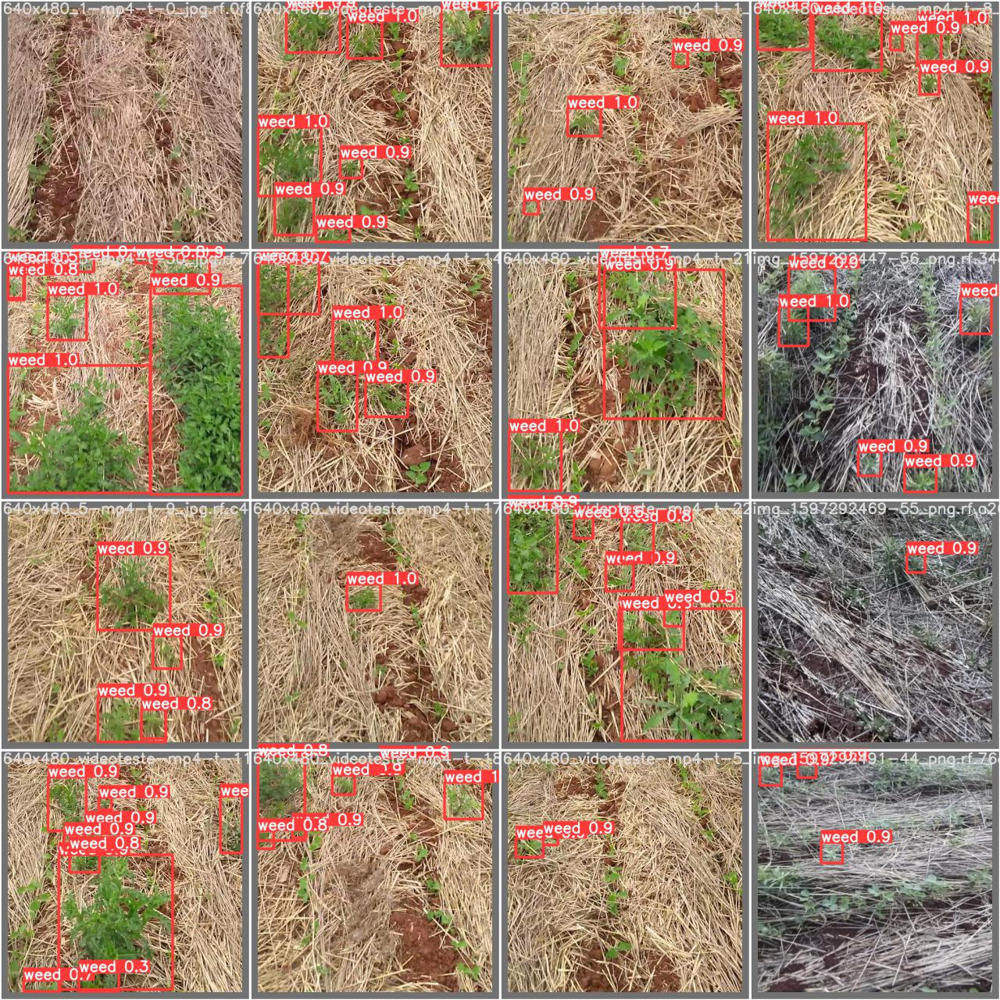

In [19]:

Image(filename='./runs/train/yolov5m_results/test_batch0_pred.jpg', width=800)  # test batch 0 predictions

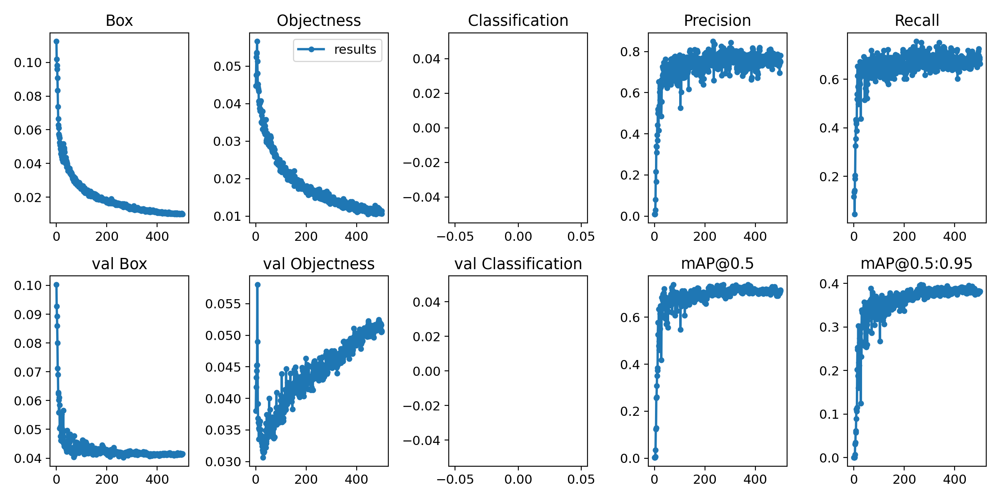

In [20]:
from utils.plots import plot_results 
plot_results(save_dir='runs/train/yolov5m_results')  # plot all results*.txt as results.png
Image(filename='runs/train/yolov5m_results/results.png', width=800)

# Test

In [21]:
!python detect.py --weights './runs/train/yolov5m_results/weights/last.pt' --img 480 --source ../test/images

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=480, iou_thres=0.45, line_thickness=3, max_det=1000, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['./runs/train/yolov5m_results/weights/last.pt'])
YOLOv5 🚀 v5.0-129-gd833ab3 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 308 layers, 21037638 parameters, 0 gradients, 50.3 GFLOPS
image 1/31 /content/yolov5/../test/images/640x480_1-mp4-t-4_jpg.rf.4944ad9e4e85d69031a3663865934f0a.jpg: 480x480 1 weed, Done. (0.017s)
image 2/31 /content/yolov5/../test/images/640x480_2-mp4-t-14_jpg.rf.969c95c264ab85834cdffd39d01ff61c.jpg: 480x480 9 weeds, Done. (0.016s)
image 3/31 /content/yolov5/../test/images/640x480_2-mp4-t-24_jpg.rf.e06f6ed5fb05387ec2b3f9c8bc64e359.jpg: 480x480 4 weeds, Done. (0.016s)
image 4/

In [22]:
%matplotlib inline

In [27]:
import os
import glob

TEST_IMAGE_PATHS= glob.glob('/content/yolov5/runs/detect/exp/*.jpg')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


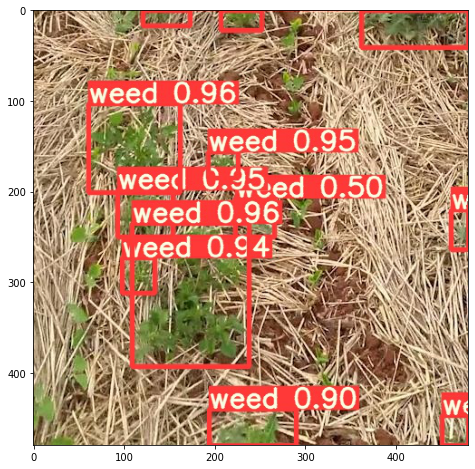

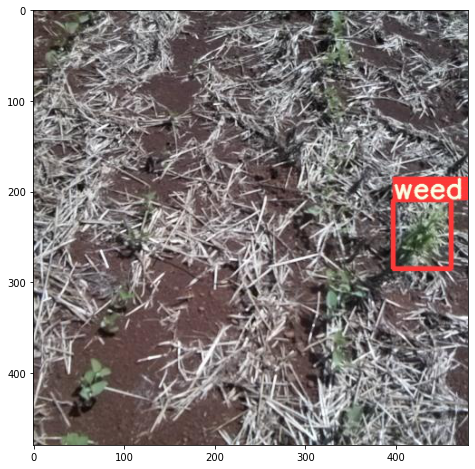

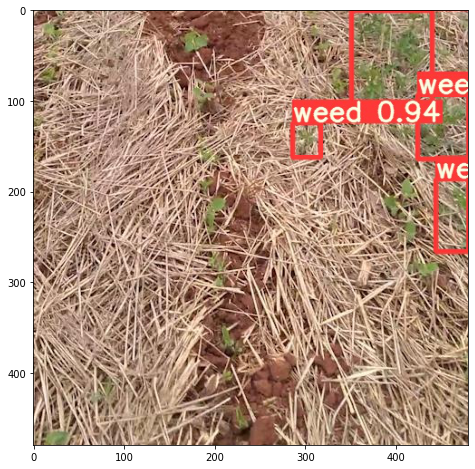

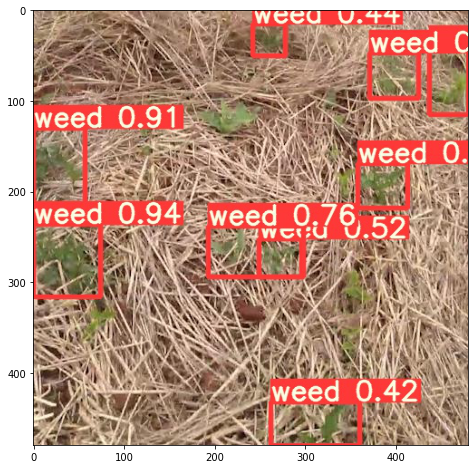

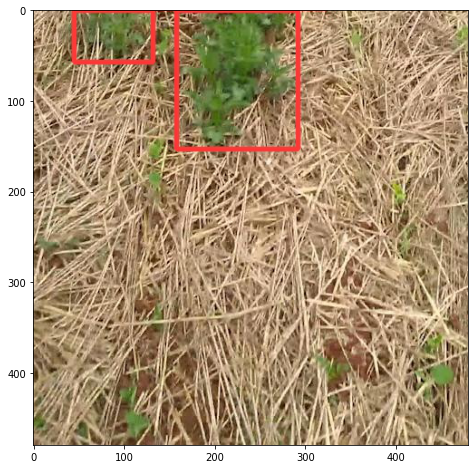

...

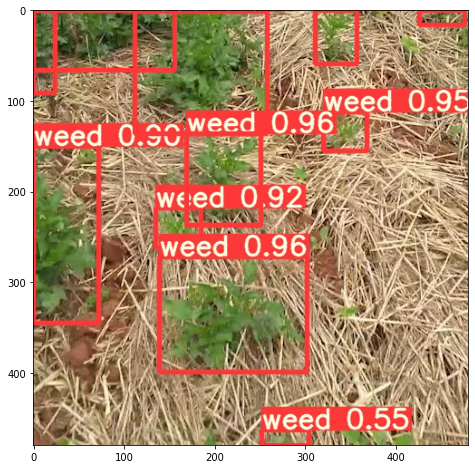

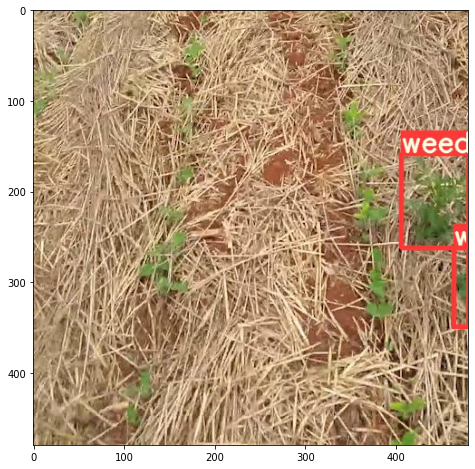

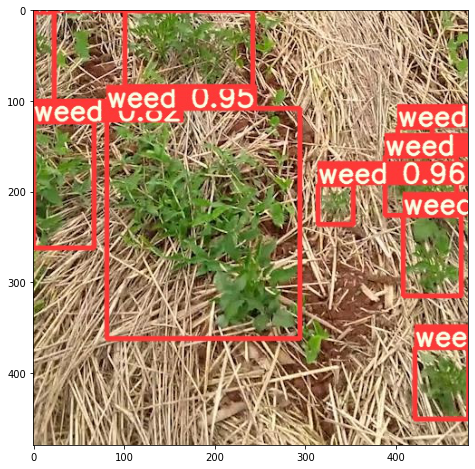

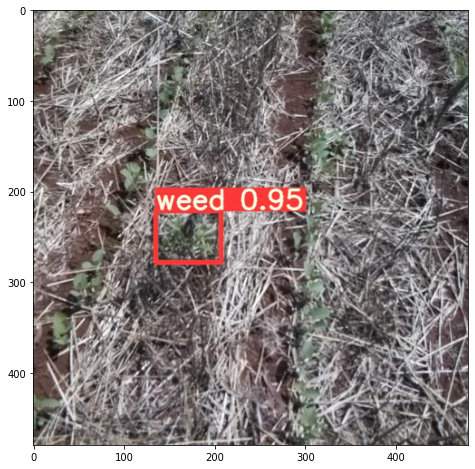

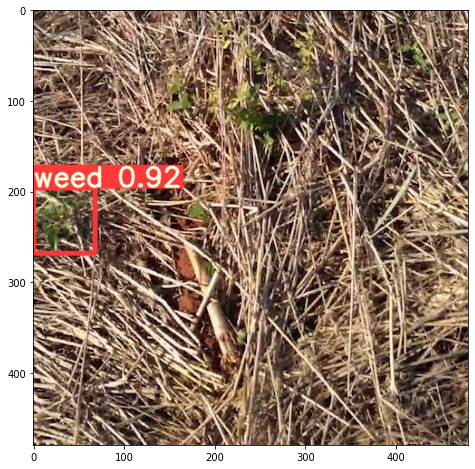

In [29]:
from matplotlib import pyplot as plt
from PIL import Image

imgslist=[]
for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    imgslist.append(image)
    plt.figure(figsize=(12,8))
    plt.imshow(image)

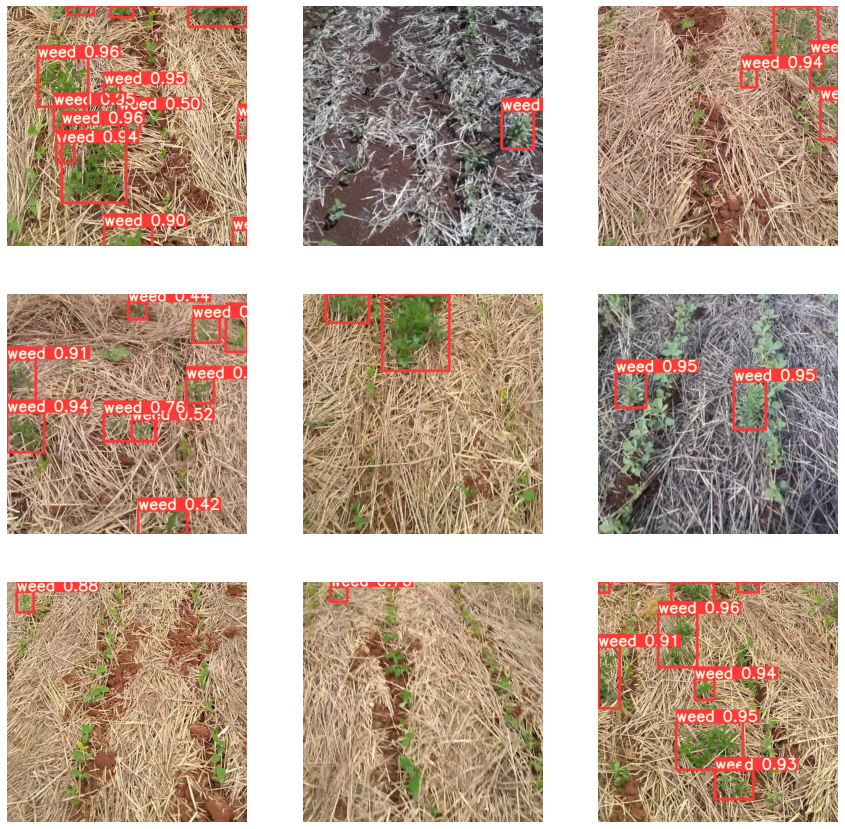

In [30]:

fig= plt.figure(figsize= (15,15))
j=0
for i in range(9):
    ax= fig.add_subplot(3, 3, j+1)
    j+=1
    plt.imshow(imgslist[i], cmap= 'gray_r')
    plt.axis('off')

#Videos

In [ ]:
# !cp /content/drive/MyDrive/video.mp4 /content/video.mp4

In [ ]:
# !python detect.py --weights './runs/train/yolov5m_results/weights/last.pt' --img 640 --source /content/video.mp4

In [ ]:
# !cp /content/yolov5/runs/detect/exp2/processed_video.mp4 /content/drive/MyDrive/